In [2]:
from qkvflow.analysis.utils import get_model
import levanter
import haliax as hax
import jax
import jax.numpy as jnp
import jax.random as jrandom
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
import einops

from plot_utils import plot_setting
from qkvflow.nn.dynamic_cp_v3 import MLP, NeuralOdeLMHeadModel

/opt/conda/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2024-05-22 06:46:23,478	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
None of PyTorch, TensorFlow >= 2.0, or Flax have been found. Models won't be available and only tokenizers, configuration and file/data utilities can be used.


In [3]:
plot_setting(font_size=18)

In [4]:
# this is to prevent loading checkpoint error
# from https://github.com/langchain-ai/langchain/issues/9014
import nest_asyncio  # noqa

nest_asyncio.apply()

In [5]:
def get_weight(model):
    attn = model.transformer.block.attn
    time_embedding = model.transformer.time_embedding
    dt = model.transformer.dt
    config = model.transformer.config 
    
    t = hax.arange(config.Layers) * dt
    time_embed = time_embedding(t)
    Qs, Ks, Os, Vs = [], [], [], []
    for l in range(config.num_layers):
        t_embed = time_embed.take("layers", l)
        Q, K, V = attn.c_attn.f_W(t_embed).unbind("qkv")
        O = attn.c_proj.f_W(t_embed)
        Qs.append(Q)
        Ks.append(K)
        Vs.append(V)
        Os.append(O)
    
    return Qs, Ks, Vs, Os

In [6]:
def examine_QK_spectra_info(Qs, Ks, n_heads, embed_size):
    n_layers = len(Qs)
    eigen_values = jnp.empty((n_layers, n_heads, embed_size))

    layer_index = 0
    for q, k in zip(Qs, Ks):

        k = k.rename({"embed": "embed_key"})
        qk = hax.dot("head_size", q, k)

        for head_index in range(n_heads):
            qk_head = jax.device_put(qk.array[:, head_index, :], jax.devices("cpu")[0])
            eigen_v, _ = jnp.linalg.eig(qk_head)
            eigen_v = jnp.sort(eigen_v, axis=-1)
            # note that this will remove the imagine part of eigenvalue
            eigen_values = eigen_values.at[layer_index, head_index].set(eigen_v)

        layer_index += 1

    return eigen_values

In [7]:
def examine_OV_spectra_info(Os, Vs, n_heads, embed_size):

    n_layers = len(Os)

    eigen_values = jnp.empty((n_layers, n_heads, embed_size))

    layer_index = 0
    for o, v in zip(Os, Vs):

        w_o = o.array
        w_v = einops.rearrange(v.array, "embed head head_size -> head embed head_size")

        w_ov = jax.vmap(jnp.matmul)(w_v, w_o)
        w_ov = jax.device_put(w_ov, jax.devices("cpu")[0])
        eigen_val, _ = jnp.linalg.eig(w_ov)
        eigen_val = jnp.sort(eigen_val, axis=-1)
        # note that this will remove the imagine part of eigenvalue
        eigen_values = eigen_values.at[layer_index].set(eigen_val)

        layer_index += 1

    return eigen_values

## Open Web Text - Medium

In [7]:
config_path = "../config/owt/medium.yaml"
checkpoint_path = "../checkpoints/gcwpvd34"
model_choice = "neuralode"
additional_args = [
    "--time_embed_dim",
    "144",
    "--sinusodial_dim",
    "512",
    "--data.cache_dir",  # need to specify in notebook
    "../cache_owt/",
]

In [8]:
trainer, model, eval_loader, tokenizer = levanter.config.main(
    get_model,
    args=[
        "--config_path",
        config_path,
        "--model_choice",
        model_choice,
        "--trainer.load_checkpoint_path",
        checkpoint_path,
        "--trainer.wandb.mode",
        "disabled",
        "--trainer.ray.start_workers",
        "false",
        "--trainer.ray.auto_start_cluster",
        "false",
    ]
    + additional_args,
)()

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
train:   0%|          | 0/40000 [00:00<?, ?it/s]2024-05-20T17:49:42 - 0 - levanter.checkpoint - checkpoint.py:365 - INFO :: Discovered latest checkpoint from ../checkpoints/gcwpvd34 at /workspaces/qkvflow/notebooks/../checkpoints/gcwpvd34/step-38895
2024-05-20T17:49:42 - 0 - levanter.checkpoint - checkpoint.py:311 - INFO :: Loading checkpoint from /workspaces/qkvflow/notebooks/../checkpoints/gcwpvd34/step-38895


In [9]:
Qs, Ks, Vs, Os = get_weight(model)

In [10]:
n_heads = model.transformer.config.num_heads
embed_size = model.transformer.config.hidden_dim

In [11]:
eigenvalues = examine_QK_spectra_info(Qs, Ks, n_heads, embed_size)

/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:94: FutureWarning: scatter inputs have incompatible types: cannot safely cast value from dtype=complex64 to dtype=float32 with jax_numpy_dtype_promotion='standard'. In future JAX releases this will result in an error.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
  return lax_internal._convert_element_type(out, dtype, weak_type)


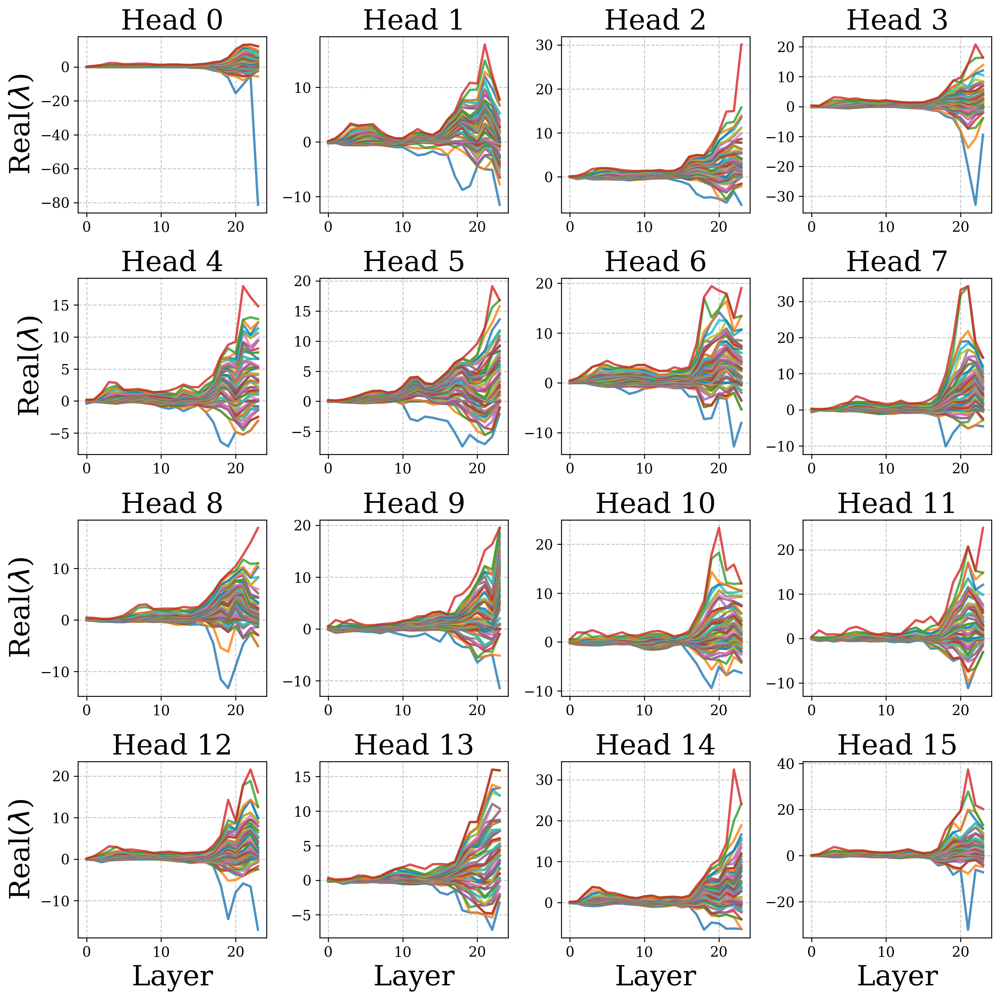

In [22]:
fig, axs = plt.subplots(4, 4, figsize=(12, 12))
for i in range(4):
    for j in range(4):
        head = i * 4 + j
        axs[i, j].plot(eigenvalues[:, head, :], alpha=0.8)

        axs[i, j].set_title(f"Head {head}", fontsize=24)
        if i == 3:
            axs[i, j].set_xlabel("Layer", fontsize=24)
        if j == 0:
            axs[i, j].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [23]:
fig.savefig(
    "../output/figures/owt_medium/qk_full.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/owt_medium/qk_full.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

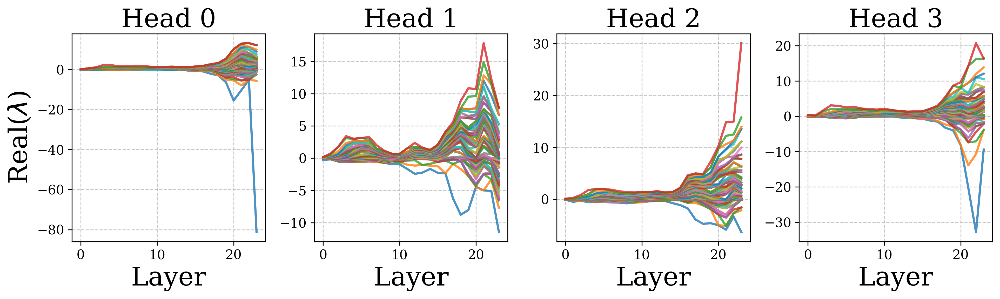

In [24]:
fig, axs = plt.subplots(1, 4, figsize=(13, 4))
for head in range(4):
    axs[head].plot(eigenvalues[:, head, :], alpha=0.8)
    axs[head].set_title(f"Head {head}", fontsize=24)
    axs[head].set_xlabel("Layer", fontsize=24)
    axs[0].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [25]:
fig.savefig(
    "../output/figures/owt_medium/qk_partial.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/owt_medium/qk_partial.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

In [20]:
ov_eigens = examine_OV_spectra_info(Os, Vs, n_heads, embed_size)

/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:94: FutureWarning: scatter inputs have incompatible types: cannot safely cast value from dtype=complex64 to dtype=float32 with jax_numpy_dtype_promotion='standard'. In future JAX releases this will result in an error.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
  return lax_internal._convert_element_type(out, dtype, weak_type)


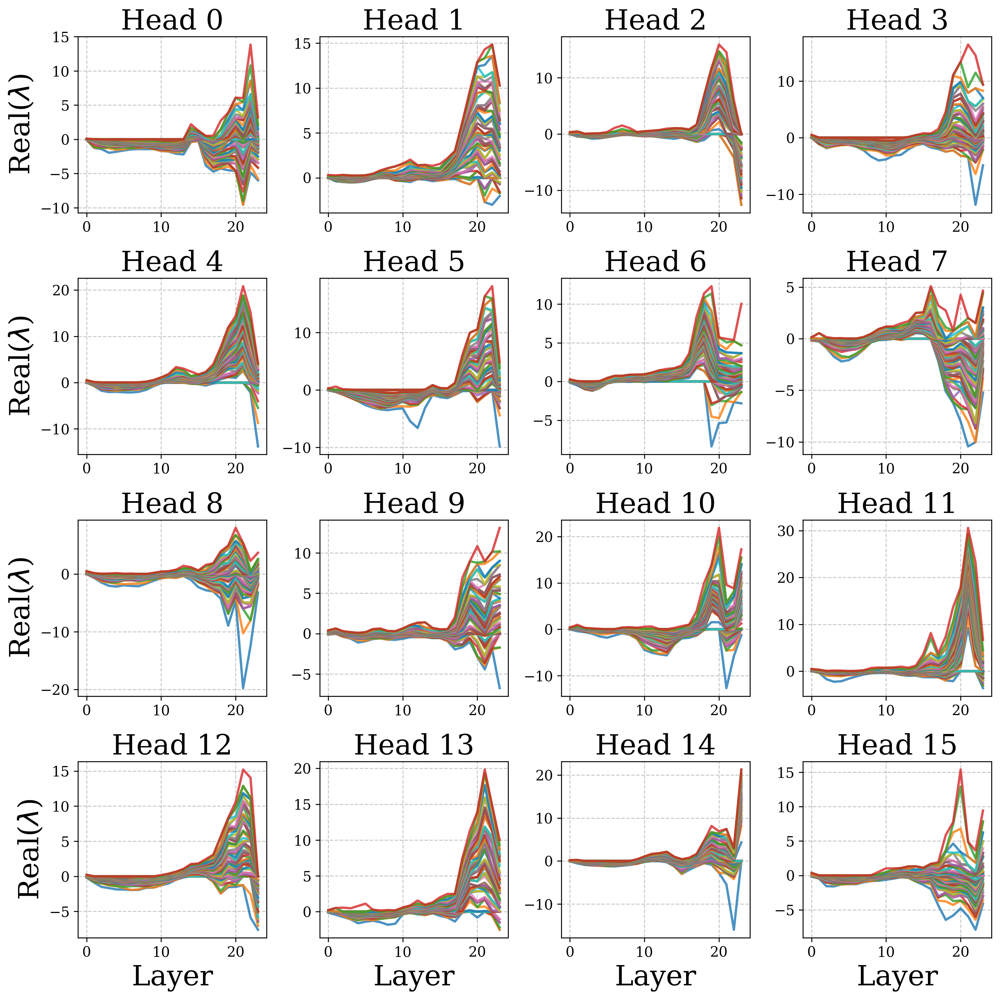

In [26]:
fig, axs = plt.subplots(4, 4, figsize=(12, 12))
for i in range(4):
    for j in range(4):
        head = i * 4 + j
        axs[i, j].plot(ov_eigens[:, head, :], alpha=0.8)

        axs[i, j].set_title(f"Head {head}", fontsize=24)
        if i == 3:
            axs[i, j].set_xlabel("Layer", fontsize=24)
        if j == 0:
            axs[i, j].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [27]:
fig.savefig(
    "../output/figures/owt_medium/ov_full.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/owt_medium/ov_full.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

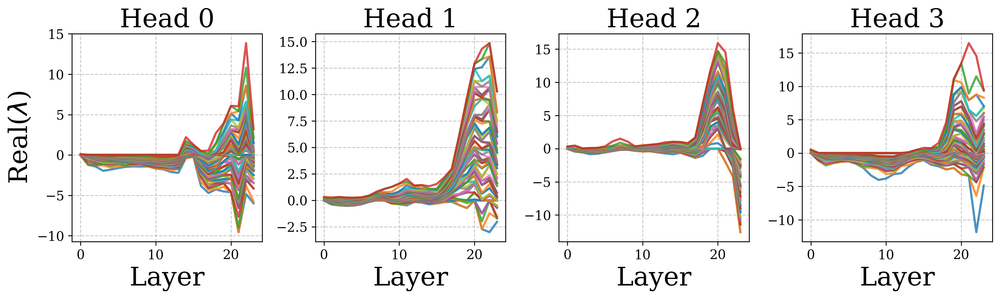

In [28]:
fig, axs = plt.subplots(1, 4, figsize=(13, 4))
for head in range(4):
    axs[head].plot(ov_eigens[:, head, :], alpha=0.8)
    axs[head].set_title(f"Head {head}", fontsize=24)
    axs[head].set_xlabel("Layer", fontsize=24)
    axs[0].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [29]:
fig.savefig(
    "../output/figures/owt_medium/ov_partial.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/owt_medium/ov_partial.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

## Open Web Text - Small

In [1]:
config_path = "../config/owt/small.yaml"
checkpoint_path = "../checkpoints/jaobw6yi"
model_choice = "neuralode"
additional_args = [
    "--time_embed_dim",
    "48",
    "--sinusodial_dim",
    "512",
    "--data.cache_dir",  # need to specify in notebook
    "../cache_owt/",
    "--multiplier",
    "2"
]

In [8]:
trainer, model, eval_loader, tokenizer = levanter.config.main(
    get_model,
    args=[
        "--config_path",
        config_path,
        "--model_choice",
        model_choice,
        "--trainer.load_checkpoint_path",
        checkpoint_path,
        "--trainer.wandb.mode",
        "disabled",
        "--trainer.ray.start_workers",
        "false",
        "--trainer.ray.auto_start_cluster",
        "false",
    ]
    + additional_args,
)()

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
train:   0%|          | 0/20000 [00:00<?, ?it/s]2024-05-22T06:47:22 - 0 - levanter.checkpoint - checkpoint.py:365 - INFO :: Discovered latest checkpoint from ../checkpoints/jaobw6yi at /workspaces/qkvflow/notebooks/../checkpoints/jaobw6yi/step-19431
2024-05-22T06:47:22 - 0 - levanter.checkpoint - checkpoint.py:311 - INFO :: Loading checkpoint from /workspaces/qkvflow/notebooks/../checkpoints/jaobw6yi/step-19431


In [9]:
Qs, Ks, Vs, Os = get_weight(model)

In [10]:
n_heads = model.transformer.config.num_heads
embed_size = model.transformer.config.hidden_dim

In [11]:
eigenvalues = examine_QK_spectra_info(Qs, Ks, n_heads, embed_size)

/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:94: FutureWarning: scatter inputs have incompatible types: cannot safely cast value from dtype=complex64 to dtype=float32 with jax_numpy_dtype_promotion='standard'. In future JAX releases this will result in an error.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
  return lax_internal._convert_element_type(out, dtype, weak_type)


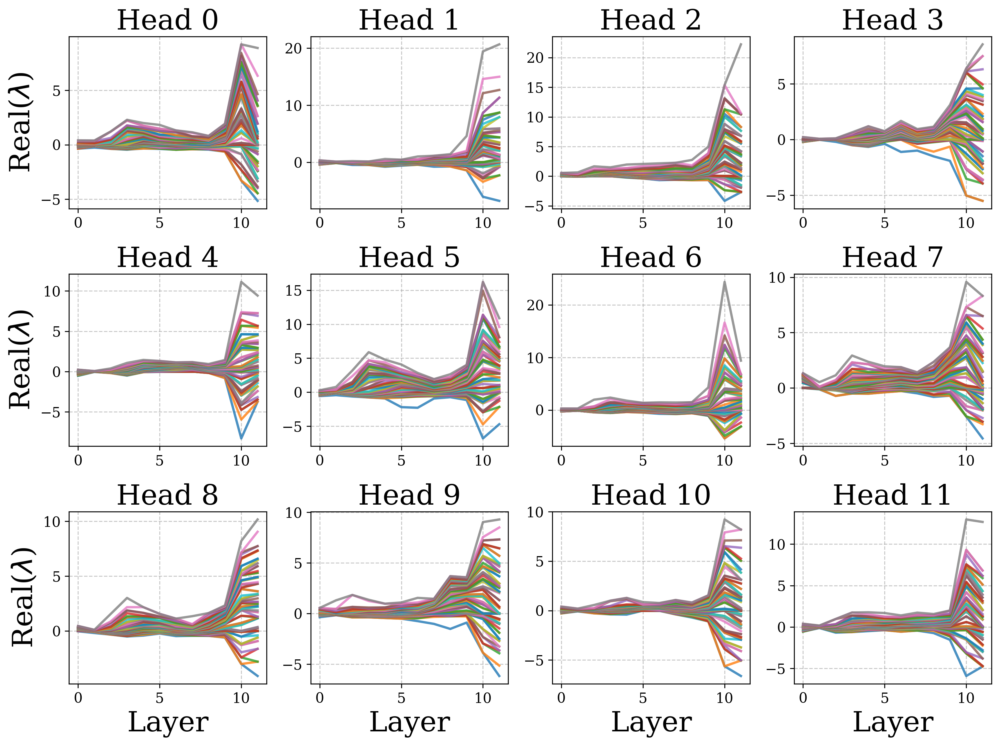

In [15]:
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
for i in range(3):
    for j in range(4):
        head = i * 4 + j
        axs[i, j].plot(eigenvalues[:, head, :], alpha=0.8)

        axs[i, j].set_title(f"Head {head}", fontsize=24)
        if i == 2:
            axs[i, j].set_xlabel("Layer", fontsize=24)
        if j == 0:
            axs[i, j].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [16]:
fig.savefig(
    "../output/figures/owt_small/qk_full.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/owt_small/qk_full.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

In [17]:
ov_eigens = examine_OV_spectra_info(Os, Vs, n_heads, embed_size)

/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:94: FutureWarning: scatter inputs have incompatible types: cannot safely cast value from dtype=complex64 to dtype=float32 with jax_numpy_dtype_promotion='standard'. In future JAX releases this will result in an error.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
  return lax_internal._convert_element_type(out, dtype, weak_type)


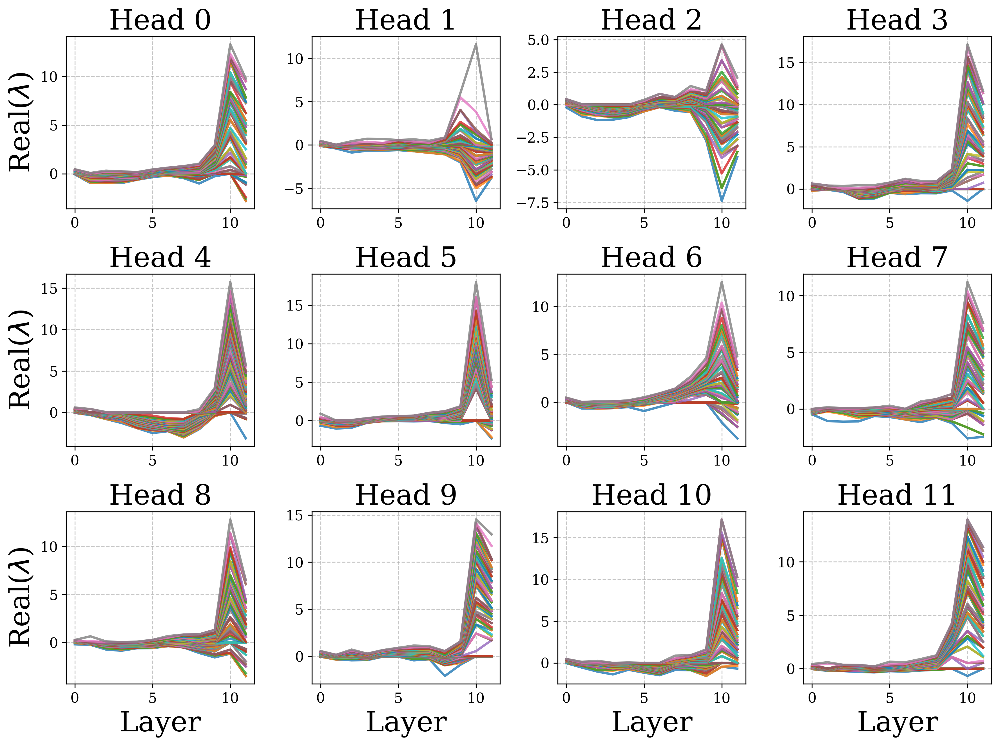

In [18]:
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
for i in range(3):
    for j in range(4):
        head = i * 4 + j
        axs[i, j].plot(ov_eigens[:, head, :], alpha=0.8)

        axs[i, j].set_title(f"Head {head}", fontsize=24)
        if i == 2:
            axs[i, j].set_xlabel("Layer", fontsize=24)
        if j == 0:
            axs[i, j].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [19]:
fig.savefig(
    "../output/figures/owt_small/ov_full.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/owt_small/ov_full.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

## Wikitext - Medium

In [20]:
config_path = "../config/wikitext_103/medium.yaml"
checkpoint_path = "../checkpoints/6uux3tzf"
model_choice = "neuralode"
additional_args = [
    "--time_embed_dim",
    "72",
    "--sinusodial_dim",
    "512",
    "--multiplier",
    "10"
]

In [21]:
trainer, model, eval_loader, tokenizer = levanter.config.main(
    get_model,
    args=[
        "--config_path",
        config_path,
        "--model_choice",
        model_choice,
        "--trainer.load_checkpoint_path",
        checkpoint_path,
        "--trainer.wandb.mode",
        "disabled",
        "--trainer.ray.start_workers",
        "false",
        "--trainer.ray.auto_start_cluster",
        "false",
    ]
    + additional_args,
)()

2024-05-22T06:58:28 - 0 - levanter.trainer - trainer.py:629 - INFO :: Setting run id to vm9n9vpp
2024-05-22T06:58:28 - 0 - levanter.logging - logging.py:194 - INFO :: Setting wandb code_dir to /workspaces/qkvflow
2024-05-22T06:58:30 - 0 - levanter.checkpoint - checkpoint.py:365 - INFO :: Discovered latest checkpoint from ../checkpoints/6uux3tzf at /workspaces/qkvflow/notebooks/../checkpoints/6uux3tzf/step-9557
2024-05-22T06:58:30 - 0 - levanter.checkpoint - checkpoint.py:311 - INFO :: Loading checkpoint from /workspaces/qkvflow/notebooks/../checkpoints/6uux3tzf/step-9557
train:   0%|          | 0/20000 [11:17<?, ?it/s]


In [22]:
Qs, Ks, Vs, Os = get_weight(model)

In [23]:
n_heads = model.transformer.config.num_heads
embed_size = model.transformer.config.hidden_dim

In [24]:
eigenvalues = examine_QK_spectra_info(Qs, Ks, n_heads, embed_size)

/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:94: FutureWarning: scatter inputs have incompatible types: cannot safely cast value from dtype=complex64 to dtype=float32 with jax_numpy_dtype_promotion='standard'. In future JAX releases this will result in an error.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
  return lax_internal._convert_element_type(out, dtype, weak_type)


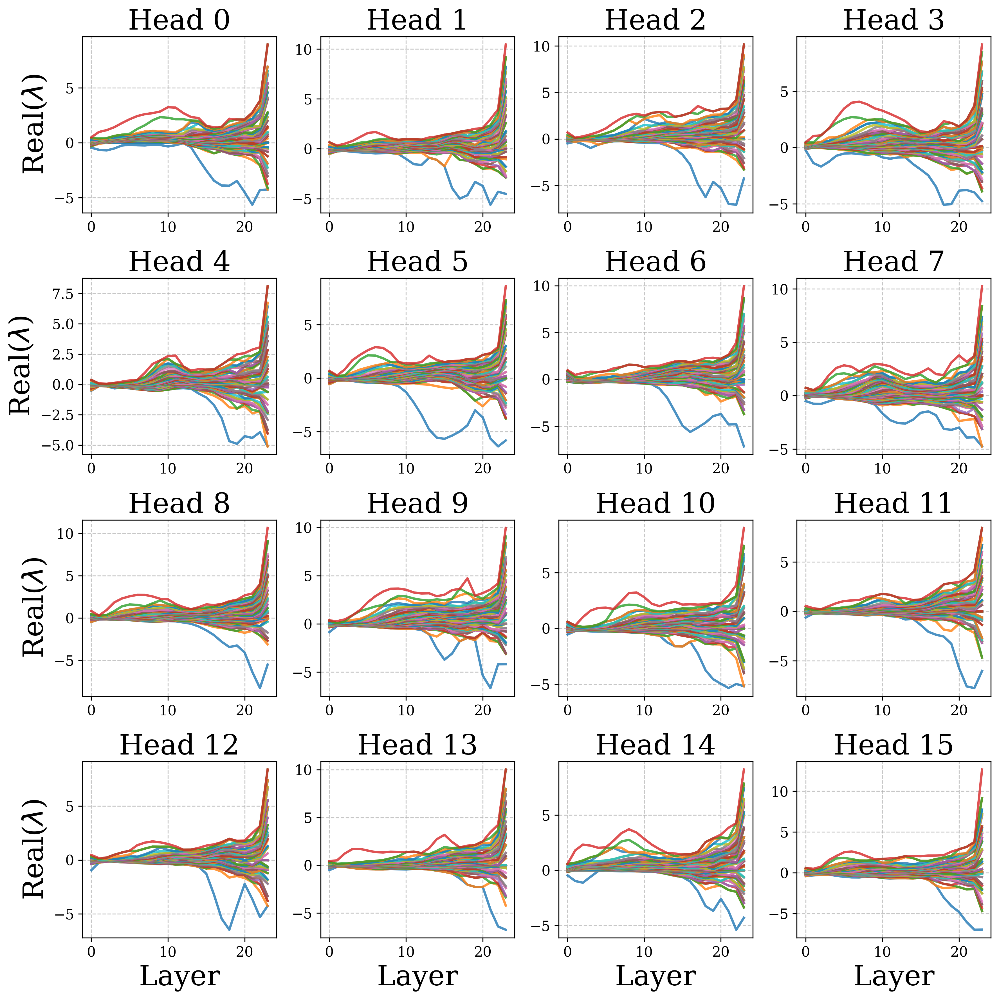

In [25]:
fig, axs = plt.subplots(4, 4, figsize=(12, 12))
for i in range(4):
    for j in range(4):
        head = i * 4 + j
        axs[i, j].plot(eigenvalues[:, head, :], alpha=0.8)

        axs[i, j].set_title(f"Head {head}", fontsize=24)
        if i == 3:
            axs[i, j].set_xlabel("Layer", fontsize=24)
        if j == 0:
            axs[i, j].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [26]:
fig.savefig(
    "../output/figures/wikitext_medium/qk_full.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/wikitext_medium/qk_full.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

In [27]:
ov_eigens = examine_OV_spectra_info(Os, Vs, n_heads, embed_size)

/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:94: FutureWarning: scatter inputs have incompatible types: cannot safely cast value from dtype=complex64 to dtype=float32 with jax_numpy_dtype_promotion='standard'. In future JAX releases this will result in an error.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
  return lax_internal._convert_element_type(out, dtype, weak_type)


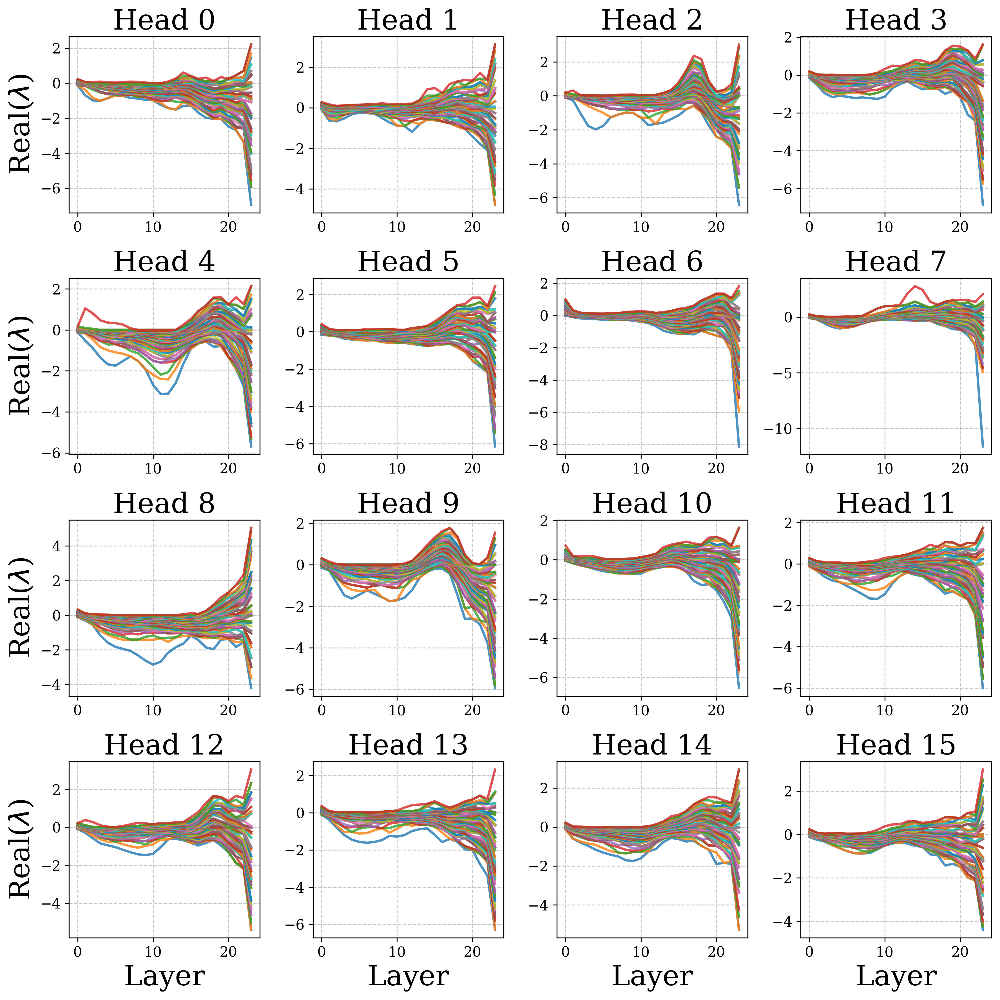

In [28]:
fig, axs = plt.subplots(4, 4, figsize=(12, 12))
for i in range(4):
    for j in range(4):
        head = i * 4 + j
        axs[i, j].plot(ov_eigens[:, head, :], alpha=0.8)

        axs[i, j].set_title(f"Head {head}", fontsize=24)
        if i == 3:
            axs[i, j].set_xlabel("Layer", fontsize=24)
        if j == 0:
            axs[i, j].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [29]:
fig.savefig(
    "../output/figures/wikitext_medium/ov_full.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/wikitext_medium/ov_full.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

## Wikitext - Small

In [30]:
config_path = "../config/wikitext_103/small.yaml"
checkpoint_path = "../checkpoints/7pcw1wvj"
model_choice = "neuralode"
additional_args = [
    "--time_embed_dim",
    "72",
    "--sinusodial_dim",
    "128",
    "--multiplier",
    "10"
]

In [31]:
trainer, model, eval_loader, tokenizer = levanter.config.main(
    get_model,
    args=[
        "--config_path",
        config_path,
        "--model_choice",
        model_choice,
        "--trainer.load_checkpoint_path",
        checkpoint_path,
        "--trainer.wandb.mode",
        "disabled",
        "--trainer.ray.start_workers",
        "false",
        "--trainer.ray.auto_start_cluster",
        "false",
    ]
    + additional_args,
)()

2024-05-22T07:17:18 - 0 - levanter.trainer - trainer.py:629 - INFO :: Setting run id to zhckdjnx
2024-05-22T07:17:18 - 0 - levanter.logging - logging.py:194 - INFO :: Setting wandb code_dir to /workspaces/qkvflow
train:   0%|          | 0/10000 [00:00<?, ?it/s]2024-05-22T07:17:19 - 0 - levanter.checkpoint - checkpoint.py:365 - INFO :: Discovered latest checkpoint from ../checkpoints/7pcw1wvj at /workspaces/qkvflow/notebooks/../checkpoints/7pcw1wvj/step-9984
2024-05-22T07:17:19 - 0 - levanter.checkpoint - checkpoint.py:311 - INFO :: Loading checkpoint from /workspaces/qkvflow/notebooks/../checkpoints/7pcw1wvj/step-9984
train:   0%|          | 0/10000 [18:55<?, ?it/s]


In [32]:
Qs, Ks, Vs, Os = get_weight(model)

In [33]:
n_heads = model.transformer.config.num_heads
embed_size = model.transformer.config.hidden_dim

In [34]:
eigenvalues = examine_QK_spectra_info(Qs, Ks, n_heads, embed_size)

/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:94: FutureWarning: scatter inputs have incompatible types: cannot safely cast value from dtype=complex64 to dtype=float32 with jax_numpy_dtype_promotion='standard'. In future JAX releases this will result in an error.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
  return lax_internal._convert_element_type(out, dtype, weak_type)


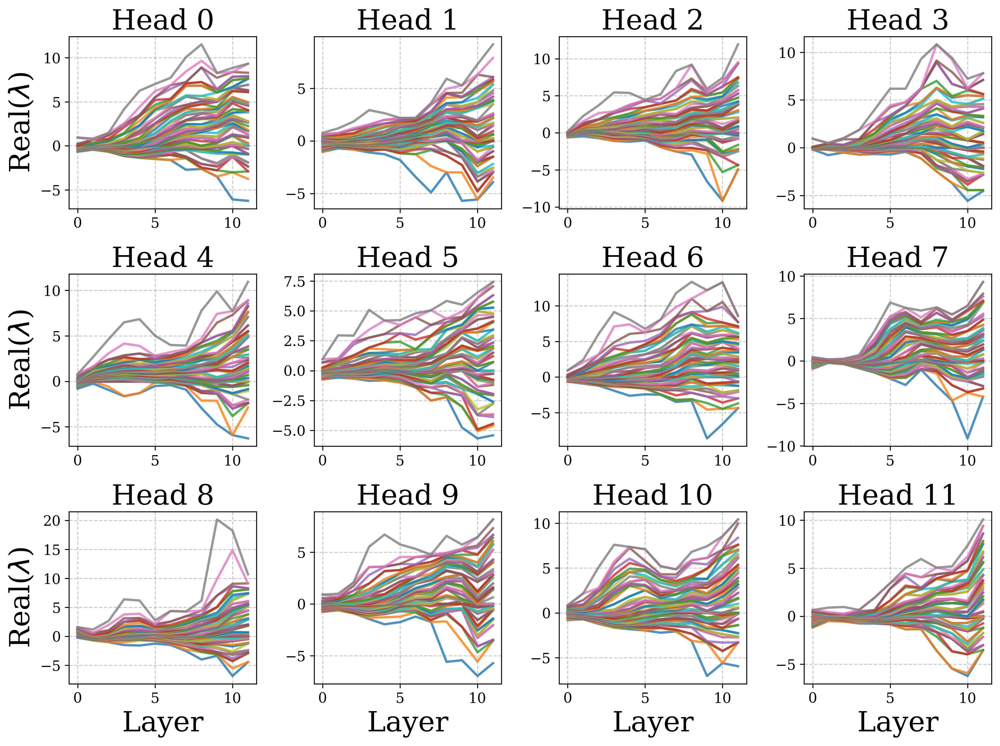

In [35]:
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
for i in range(3):
    for j in range(4):
        head = i * 4 + j
        axs[i, j].plot(eigenvalues[:, head, :], alpha=0.8)

        axs[i, j].set_title(f"Head {head}", fontsize=24)
        if i == 2:
            axs[i, j].set_xlabel("Layer", fontsize=24)
        if j == 0:
            axs[i, j].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [36]:
fig.savefig(
    "../output/figures/wikitext_small/qk_full.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/wikitext_small/qk_full.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)

In [37]:
ov_eigens = examine_OV_spectra_info(Os, Vs, n_heads, embed_size)

/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:94: FutureWarning: scatter inputs have incompatible types: cannot safely cast value from dtype=complex64 to dtype=float32 with jax_numpy_dtype_promotion='standard'. In future JAX releases this will result in an error.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/jax/_src/ops/scatter.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
  return lax_internal._convert_element_type(out, dtype, weak_type)


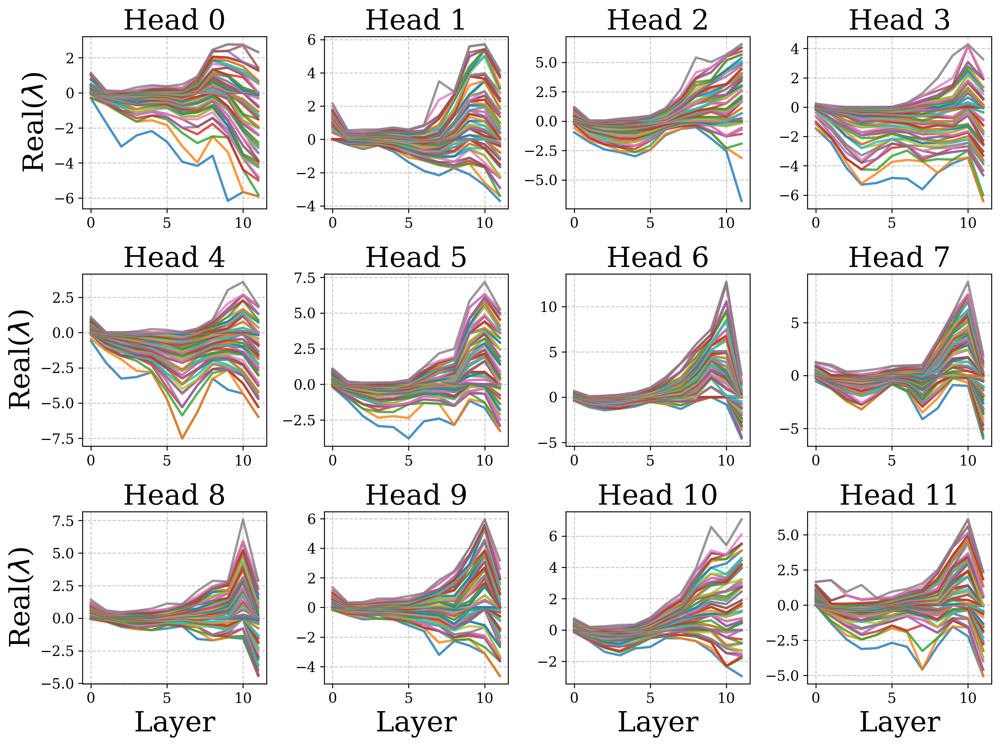

In [38]:
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
for i in range(3):
    for j in range(4):
        head = i * 4 + j
        axs[i, j].plot(ov_eigens[:, head, :], alpha=0.8)

        axs[i, j].set_title(f"Head {head}", fontsize=24)
        if i == 2:
            axs[i, j].set_xlabel("Layer", fontsize=24)
        if j == 0:
            axs[i, j].set_ylabel(r"Real($\lambda$)", fontsize=24)

plt.tight_layout()

In [39]:
fig.savefig(
    "../output/figures/wikitext_small/ov_full.pdf",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)
fig.savefig(
    "../output/figures/wikitext_small/ov_full.jpg",
    dpi=300,
    bbox_inches="tight",
    transparent=True,
)